<a href="https://colab.research.google.com/github/PurpleDin0/QDA_NLG_Detection/blob/master/Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Perform Quantitative Discursive Analysis on Machine and Human Generated Text

## Load all the relevant libraries & clone relevant repo's
---
- [Quantitative-Discursive-Analysis](QDA)(https://github.com/metalcorebear/Quantitative-Discursive-Analysis) (v0.0.1): This is a library by [@metalcorebear](https://github.com/metalcorebear) that simplifies the creation of discursive objects and performing resonance analysis of those objects to each other.  I am importing a forked version of the QDA code, as this notebook is dependent upon the v0.0.1 code.  Additionally, the QDA code also requires several other packages in order to run successfully.
  -  [NumPy](https://numpy.org/) (v1.18.0): Needed as part of QDA and to compute statistics of the resonance matrices.
  -  [NetworkX](https://networkx.github.io/) (v2.3): Version 2.4 of NetworkX is incompatible with this notebook.
  -  [textblob](https://textblob.readthedocs.io/en/dev/) (v0.16.0): used as part of the QDA module.
- [pandas](https://pandas.pydata.org/) (v1.0.4): used to read in CSV data, do basic data cleaning, and store all our data.  This is a heavy hitter of Python for Data Science.
- [plot.ly](https://plot.ly/python/getting-started/) (v4.8.1.): Express is used for simple graphs and graph_objects is used for more complicated graphs.
 - NOTE: prior to [version 4.0](https://medium.com/plotly/plotly-py-4-0-is-here-offline-only-express-first-displayable-anywhere-fc444e5659ee) of plot.ly it defaulted to an online mode that was widely despised, but v4.0 fixes this issue.

  The below code also returns the versions of some of the modules, to help with documentation/academic paper writing.

- Clone the [QDA_NLG_Detection](https://github.com/PurpleDin0/QDA_NLG_Detection) repo:  This repo contains all the Jupyter notebooks and source data that enables the workbooks.  With the exception of any dependent libraries (and Python/iPython interpreter) it contains everything needed to replicate this analysis. 

## Configure your environment

**Colab**
- This notebook was designed to use Google's Colaboratory Jupyter Notebook environment.
- No additional modifications are needed to run the notebook if you are using Colab.

**Azure**
- If you are in an Azure environment, you MUST ensure you are running python 3.6.
- Also, you need to run the below code to move you to the right directory.

**Local**
- If you are in a local environment you need to change to a local directory that you can use.
- You also will need to have git and pip installed and be running this notebook as an administrator.
- It is not recommended to run this notebook in a local non-virtual environment.

In [1]:
## if you are using Azure uncomment and run the below line
#%cd /tmp

# That changed your directory to the /tmp dir in Azure.  
# Azure defaults you to the /home/nbuser/library directory which is VERY VERY slow

## if you are using a local notebook set the working dir to whatever yours is by uncommenting and running the below line
#%cd c:\\temp
    
## Check python version
!python --version

Python 3.6.9


## import all the required code/data

In [2]:
import os
# 0. Clone the repos and then change the working directory to the cloned folder
git_repo1 =  'QDA_NLG_Detection'  # 1st repo we want to clone
git_repo2 =  'Quantitative-Discursive-Analysis' # 2nd repo we want to clone
git_user = 'PurpleDin0' # User/org we want to clone the repo from

repo1_dir = os.path.join(os.getcwd(), git_repo1)
repo2_dir = os.path.join(os.getcwd(), git_repo2)

# Clone the QDA_NLG_Detection repository 
!git clone https://github.com/{git_user}/{git_repo1}.git
# Clone the fork of @metalcorebear's Quantitative-Discursive-Analysis repository 
!git clone https://github.com/{git_user}/{git_repo2}.git

# navigate to the QDA_NLG_Detection folder
os.chdir(repo1_dir)

# install required modules
# WARNING: Code is not compatible with networkx v2.4, this installs the compatable version 2.3
!pip install -r requirements.txt   

# navigate to the Quantitative-Discursive-Analysis folder and import the modules
# Note: instead of cloning the repo we could "!pip install QDA"
os.chdir(repo2_dir)
import QDA as QDA         
 
import pandas as pd  #import pandas
print("Pandas imported as Version: ",pd.__version__)

import plotly #import plotly
print("Plotly imported as Version: ",plotly.__version__)
import plotly.express as px

import pickle                     #So we can save any of our output variables for later use
import json                       #So we can import our saved JSON data

import nltk
nltk.download('brown')
nltk.download('punkt')

import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx

Cloning into 'QDA_NLG_Detection'...
remote: Enumerating objects: 32, done.
remote: Counting objects: 100% (32/32), done.
remote: Compressing objects: 100% (30/30), done.
remote: Total 93 (delta 9), reused 10 (delta 1), pack-reused 61
Unpacking objects: 100% (93/93), done.
Checking out files: 100% (26/26), done.
Cloning into 'Quantitative-Discursive-Analysis'...
remote: Enumerating objects: 20, done.
remote: Counting objects: 100% (20/20), done.
remote: Compressing objects: 100% (19/19), done.
remote: Total 20 (delta 6), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (20/20), done.
     |████████████████████████████████| 11.5MB 268kB/s 
     |████████████████████████████████| 1.8MB 52.9MB/s 
     |████████████████████████████████| 245kB 37.5MB/s 
  Created wheel for networkx: filename=networkx-2.3-py2.py3-none-any.whl size=1556408 sha256=0f6723cb0013b9760a933e646ac1b8bd775335c94d9ee80e13a210c510b26a87
  Stored in directory: /root/.cache/pip/wheels/de/63/64/3699be2a9d0ccdb37c7

In [3]:
## Define functions 
# Cool banner printer
def banner(t, s='~'):
    l = s * (len(t) + 4)
    print(l + '\n' + '{0} {1} {0}'.format(s, t) + '\n' + l)

# Formatted line
def line(t):
  print("\n", "~"*(26-(len(t)//2)), t, "~"*(26-(len(t)//2)))

banner('environment configured')

~~~~~~~~~~~~~~~~~~~~~~~~~~
~ environment configured ~
~~~~~~~~~~~~~~~~~~~~~~~~~~


#Read in the data & create a dataframe from each source text 
Next we will read in the data to begin our analysis
* [x] **GPT-2 data:** This data was created by fine-tuning a 124M-parameter GPT-2 model with the Sputnik News data.  [Link to workbook here](https://github.com/PurpleDin0/QDA_NLG_Detection/blob/master/Train%20a%20GPT-2%20Text-Generating%20Model%20w_%20GPU.ipynb)
* [x] **Markovify data:** This data was created by training the markovify model with the Sputnik News data.  [Link to workbook here](https://github.com/PurpleDin0/QDA_NLG_Detection/blob/master/Data_Cleaining.ipynb)
* [x] **Sputnik News training data:** This is full text date we exported and trained the above two models on.
* [x] **Sputnik News control data:** This is example data from Sputnik News that was not used to train the models.






## Create GPT Text dataframe

In [4]:
#navigate to where the data is stored
os.chdir(os.path.join(repo1_dir, 'Data'))

#Open the data we generated with our fine tuned GPT-2 Model 
#Note: Due to GPU/RAM usage I had to make my file in 6 seperate runs this code recombines those files 
gpt_text_data = []
for n in range(1, 5):
    file_name = "gpt_sputnik_text_data_" + str(n) + ".json"
    
    with open(file_name, "r", encoding="utf8") as gpt_read_file:
        gpt_text_data += json.load(gpt_read_file)

# Build the DataFrame with GPT-2 generated text
gpt_df = pd.DataFrame(gpt_text_data, columns=['text']) #Store the GPT data in a DataFrame
gpt_df['length'] = gpt_df['text'].apply(lambda x : len(x)) #find the character length of each article
gpt_df['Sentance_count'] = gpt_df['text'].apply(lambda x : x.count('.')) #approximate sentance count of each article
gpt_df['Text_clean'] = gpt_df['text'].apply(lambda x : x.lower()) #make the text of each article lowercase
gpt_df['Text_clean'] = gpt_df['Text_clean'].str.replace('\n',' ') #remove new lines "\n" from the dataset
gpt_df['Text_clean'] = gpt_df['Text_clean'].str.replace('[^\w\s]','') #clean the data to remove all special characters and punctuation
gpt_df['word_count'] = gpt_df['Text_clean'].apply(lambda x : len(x.split())) #more accurate word count after all special chars have been removed

## Create the Markovify dataframe
1. Import the Markovify data trained on the human text
2. Merge the individual Markovify sentences into article length content.  This is done to provide similar length text corpora.  However, as the Markovify text generator is limited to sentence length content generation, this will create a seemingly random string of sentences.  This will likely result in the markovify content being deemed more discursively dissimilar to coherent article length content.  As Markovify is a content generator that lacks the ["Attention Mechansism"](http://jalammar.github.io/illustrated-gpt2/) of GPT-2 or many of the other advanced natural language generation models.  Since this is a fundamental weakness of text-generation using Markovify, and is an acceptable issue with the dataset.   

In [5]:
#navigate to where the data is stored
os.chdir(os.path.join(repo1_dir, 'Data'))

# Open the data we generated with Markovify 
with open("markovify_text_stored.json", "r", encoding="utf8") as markovify_read_file: 
    markovify_text_data = json.load(markovify_read_file)
markovify_sentences = ['']
i = 0
for sentence in markovify_text_data:
    markovify_sentences[i] += sentence + ' '
    if len(markovify_sentences[i]) > gpt_df['length'].mean():
        markovify_sentences.append('')
        i += 1
 
# Build the DataFrame with markovify generated text
markovify_df = pd.DataFrame(markovify_sentences, columns=['text'])
markovify_df['length'] = markovify_df['text'].apply(lambda x : len(x)) #find the character length of each "article"
markovify_df['Sentance_count'] = markovify_df['text'].apply(lambda x : x.count('.')) #approximate sentance count of each "article"
markovify_df['Text_clean'] = markovify_df['text'].apply(lambda x : x.lower()) #make the text of each article lowercase
markovify_df['Text_clean'] = markovify_df['Text_clean'].str.replace('\n',' ') #remove new lines "\n" from the dataset
markovify_df['Text_clean'] = markovify_df['Text_clean'].str.replace('[^\w\s]','') #clean the data to remove all special characters and punctuation
markovify_df['word_count'] = markovify_df['Text_clean'].apply(lambda x : len(x.split())) #more accurate word count after all special chars have been removed

## Create the human text dataframe
1. [x] Input the human text that was used to train the markovify and fine-tune the GPT-2 model.  
  ***NOTE: This data was used to train the model, and we are using it to compare against the trained model to increase the potential that we will find resonance between the trained models and the source text.  If there is little resonance found we can assume that using a different set of human text will further decrease resonance.***  
2. [X] Input a second selection of human text in the same style of the training text (e.g. Sputnik data from a different time period).  This dataset should have a lower resonance then the training/fine-tuning dataset as topics in discourse tend to drift over time.  We will load sputnik data from the ~2 weeks before and after the training data.

In [6]:
#navigate to where the data is stored
os.chdir(os.path.join(repo1_dir, 'Data'))

# Load the file that contains the data used to train the model
# This Dataframe will consist of English_Language-State_Media from 15 Oct 2019 to 15 Nov 2019
training_data = pd.read_csv('English_Language-State_Media-10_15_to_11_15-2019.csv') #imports the file

#cleans up the columns by replacing spaces with "_"
training_data.columns = training_data.columns.str.replace(' ', '_')  

training_data = training_data.drop(columns=['Unnamed:_0']) #drop the old index from the csv file

#Replace NA content in the Body column with blank (i.e. "") values
values = {'Body': ""} #create a dictionary with the columns that you want to search and the value you want to replace.
training_data = training_data.fillna(value=values) #Replaces all NA values based on the values dictionary

In [7]:
#navigate to where the data is stored
os.chdir(os.path.join(repo1_dir, 'Data'))

# Load the file that contains data that wasn't used to train the model
# This Dataframe will consist of English_Language-State_Media from ~2 weeks before and after the data used to train the model

#Load the two files and create one DataFrame using the data not used to train the model
other_data = pd.concat([pd.read_csv('English_Language-State_Media-10_01_to_10_14-2019.csv') ,
                        pd.read_csv('English_Language-State_Media-11_16_to_11_30-2019.csv')
                       ])
# Reset the index after joining the dataframes
other_data = other_data.reset_index(drop=True) 

#cleans up the columns by replacing spaces with "_"
other_data.columns = other_data.columns.str.replace(' ', '_') 

other_data = other_data.drop(columns=['Unnamed:_0']) #drop the old index from the csv file

#Replace NA content in the Body column with blank (i.e. "") values
values = {'Body': ""} #create a dictionary with the columns that you want to search and the value you want to replace.
other_data = other_data.fillna(value=values) #Replaces all NA values based on the values dictionary

### Select the human generated content
1. [X] Get the Sputnik data that was used to train the model.  We will further reduce our selected data by selecting the data with min/max length similar to that of both the GPT and Markovify machine generated text data.
2. [X] Get the Sputnik data that was not used to train the model.  We will further reduce our selected data by selecting the data with min/max length similar to that of both the GPT and Markovify machine generated text data.

In [ ]:
###############################################################################
# Build the Dataframe with the sputnik training data
sputnik_training_df = training_data.loc[training_data['Source_Name'] == 'Sputnik', :]

sputnik_training_df['length'] = sputnik_training_df['Body'].apply(lambda x : len(x))

# Drop the long (over 4000 characters) and short (under 3000 characters) articles from the dataframe
# This is done to ensure the content length of each article is approxamitley the same at 3500 characters, which is about 575 words or 1 page. 
sputnik_training_df = sputnik_training_df[sputnik_training_df.length.between(3000, 4000)]

# Add additional information to the dataframe
sputnik_training_df['length'] = sputnik_training_df['Body'].apply(lambda x : len(x)) #find the character length of each "article"
sputnik_training_df['Sentance_count'] = sputnik_training_df['Body'].apply(lambda x : x.count('.')) #approximate sentance count of each "article"
sputnik_training_df['Text_clean'] = sputnik_training_df['Body'].apply(lambda x : x.lower()) #make the text of each article lowercase
sputnik_training_df['Text_clean'] = sputnik_training_df['Text_clean'].str.replace('\n',' ') #remove new lines "\n" from the dataset
sputnik_training_df['Text_clean'] = sputnik_training_df['Text_clean'].str.replace('[^\w\s]','') #clean the data to remove all special characters and punctuation
sputnik_training_df['word_count'] = sputnik_training_df['Text_clean'].apply(lambda x : len(x.split())) #more accurate word count after all special chars have been removed

###############################################################################
# Build the Dataframe with the sputnik data that was not used for training
sputnik_other_df = other_data.loc[other_data['Source_Name'] == 'Sputnik', :]

sputnik_other_df['length'] = sputnik_other_df['Body'].apply(lambda x : len(x))

# Drop the long (over 4000 characters) and short (under 3000 characters) articles from the dataframe
# This is done to ensure the content length of each article is approxamitley the same at 3500 characters, which is about 575 words or 1 page. 
sputnik_other_df = sputnik_other_df[sputnik_other_df.length.between(3000, 4000)]

# Add additional information to the dataframe
sputnik_other_df['length'] = sputnik_other_df['Body'].apply(lambda x : len(x)) #find the character length of each "article"
sputnik_other_df['Sentance_count'] = sputnik_other_df['Body'].apply(lambda x : x.count('.')) #approximate sentance count of each "article"
sputnik_other_df['Text_clean'] = sputnik_other_df['Body'].apply(lambda x : x.lower()) #make the text of each article lowercase
sputnik_other_df['Text_clean'] = sputnik_other_df['Text_clean'].str.replace('\n',' ') #remove new lines "\n" from the dataset
sputnik_other_df['Text_clean'] = sputnik_other_df['Text_clean'].str.replace('[^\w\s]','') #clean the data to remove all special characters and punctuation
sputnik_other_df['word_count'] = sputnik_other_df['Text_clean'].apply(lambda x : len(x.split())) #more accurate word count after all special chars have been removed


## Analyze the four dataframes
Check the length of the four dataframes to ensure the text content is of similar size

In [9]:
#Print the basics statistics for the four dataframes
banner('****************** GPT Data ******************')
print(gpt_df.describe(), '\n')

banner('*************** Markovify Data ***************')
print(markovify_df.describe(), '\n')

banner('************ Sputnik training Data ***********')
print(sputnik_training_df.describe(), '\n') 

banner('************* Other Sputnik Data *************')
print(sputnik_other_df.describe(), '\n')

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
~ ****************** GPT Data ****************** ~
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
            length  Sentance_count  word_count
count   500.000000      500.000000  500.000000
mean   3548.610000       27.096000  599.680000
std     377.406392        8.805786   73.528951
min     855.000000        1.000000   12.000000
25%    3395.000000       23.000000  586.000000
50%    3602.500000       27.000000  613.500000
75%    3785.250000       30.000000  636.000000
max    4345.000000      156.000000  699.000000 

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
~ *************** Markovify Data *************** ~
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
            length  Sentance_count  word_count
count   544.000000      544.000000  544.000000
mean   3680.511029       25.011029  599.768382
std     130.969061        4.018817   23.790399
min    2659.000000       11.000000  428.000000
25%    3587.000000       22.000000

# Instantiate discursive objects for each text corpora
* [x] Create a QDA discursive object for each article in the markovify, GPT-2, and human text data.  
  Compute Time Note: on Google Colab QDA objects can be created for each ~1500 articles in under 1 minute.
* [x] Add these QDA objects to the dataframe

In [ ]:
## Compute the QDA object for each "article" in the four Dataframes

markovify_df['QDA_object'] = markovify_df['text'].apply(lambda x :  QDA.discursive_object(x))

gpt_df['QDA_object'] = gpt_df['text'].apply(lambda x :  QDA.discursive_object(x))

sputnik_training_df['QDA_object'] = sputnik_training_df['Body'].apply(lambda x :  QDA.discursive_object(x))

sputnik_other_df['QDA_object'] = sputnik_other_df['Body'].apply(lambda x :  QDA.discursive_object(x))

In [ ]:
# Save the data locally for future use
pickle.dump(markovify_df, open( "markovify_df.p", "wb" ) )
pickle.dump(gpt_df, open( "gpt_df.p", "wb" ) )
pickle.dump(sputnik_training_df, open( "sputnik_training_df.p", "wb" ) )
pickle.dump(sputnik_other_df, open( "sputnik_other_df.p", "wb" ) )

# Create the Discursive simularity matrixs

1. [x] Create a discursive community matrix for the GPT, Markovify, training, and human created text data
2. [x] Create a discursive community matrix for a sample of the GPT, Markovify, training human text, and non-training human text data.  This was done as it was not possible to create a matrix for all of the generated text and human text training data.

In [11]:
# Read in the saved dataframes for the 4 source data types (i.e. GPT, Markovify, training, control)
os.chdir(os.path.join(repo1_dir, 'Data'))
gpt_df = pd.read_pickle("gpt_df.p")
markovify_df = pd.read_pickle("markovify_df.p")
sputnik_training_df = pd.read_pickle("sputnik_training_df.p")
sputnik_other_df = pd.read_pickle("sputnik_other_df.p")

In [ ]:
# Navigate to the folder where the data will be saved
os.chdir(os.path.join(repo1_dir, 'Data'))

# Create the discursive community matrix for the GPT data 
gpt_discursive_community = QDA.discursive_community(gpt_df['QDA_object'].to_list())

# Save the discursive community matrix to Google Drive for later input
pickle.dump(gpt_discursive_community, open( "gpt_discursive_community.p", "wb" ) )

# Create the discursive community matrix for the markovify data 
markovify_discursive_community = QDA.discursive_community(markovify_df['QDA_object'].to_list())
 
# Save the discursive community matrix to Google Drive for later input
pickle.dump(markovify_discursive_community, open( "markovify_discursive_community.p", "wb" ) )
 
# Create the discursive community matrix for the Sputnik training data 
sputnik_training_discursive_community = QDA.discursive_community(sputnik_training_df['QDA_object'].to_list())
 
# Save the discursive community matrix to Google Drive for later input
pickle.dump(sputnik_training_discursive_community, open( "sputnik_training_discursive_community.p", "wb" ) )

# Create the discursive community matrix for the Sputnik control data 
sputnik_other_discursive_community = QDA.discursive_community(sputnik_other_df['QDA_object'].to_list())
 
# Save the discursive community matrix to Google Drive for later input
pickle.dump(sputnik_other_discursive_community, open( "sputnik_other_discursive_community.p", "wb" ) )


In [ ]:
## WARNING: Quantity of objects in the three dataframes is ~1500 and is too large to analyze with Google Colab
## Create the discursive community matrix for the entire dataset
## Below lines are commented out as the computation requires in excessive amount of time/computer resources
#merged_QDA_objects = gpt_df['QDA_object'].to_list() + markovify_df['QDA_object'].to_list() + sputnik_df['QDA_object'].to_list()
#merged_discursive_community = QDA.discursive_community(merged_QDA_objects)

In [ ]:
# Create a discursive community matrix for a subset of the entire dataset
# select a random 100 entries from each text set (GPT, Markovify, and Human_text)
# to enable result reproducibilty random_sate is set to the integer "1984" 

gpt_sample_df = gpt_df.sample(n=100, random_state=1984)
markovify_sample_df = markovify_df.sample(n=100, random_state=1984)
sputnik_training_sample_df = sputnik_training_df.sample(n=100, random_state=1984)
sputnik_other_sample_df = sputnik_other_df.sample(n=100, random_state=1984)

sample_discursive_objects = ( gpt_sample_df['QDA_object'].to_list()       + 
                              markovify_sample_df['QDA_object'].to_list() +
                              sputnik_training_sample_df['QDA_object'].to_list()   +
                              sputnik_other_sample_df['QDA_object'].to_list() )

sample_discursive_community = QDA.discursive_community(sample_discursive_objects)

# Navigate to the folder where the data will be saved
# Save the discursive community matrix for later use
os.chdir(os.path.join(repo1_dir, 'Data'))
pickle.dump(sample_discursive_community, open( "sample_discursive_community.p", "wb" ) )


# Analyze Discursive similarity matrix

1. [X] Load the discursive community matrix for GPT, Markovify, and Human text (training and control)
2. [X] Analyze that data 



## Load the discursive community matrix

In [12]:
# Navigate to the directory the discursive community objects are stored
os.chdir(os.path.join(repo1_dir, 'Data'))

# Load the discursive community matrices into dataframes

sample_discursive_community = pd.read_pickle("sample_discursive_community.p")
sample_discursive_community_df = pd.DataFrame(sample_discursive_community.A)

gpt_discursive_community = pd.read_pickle("gpt_discursive_community.p")
gpt_discursive_community_df = pd.DataFrame(gpt_discursive_community.A)

markovify_discursive_community = pd.read_pickle("markovify_discursive_community.p")
markovify_discursive_community_df = pd.DataFrame(markovify_discursive_community.A)

sputnik_training_discursive_community = pd.read_pickle("sputnik_training_discursive_community.p")
sputnik_training_discursive_community_df = pd.DataFrame(sputnik_training_discursive_community.A)

sputnik_other_discursive_community = pd.read_pickle("sputnik_other_discursive_community.p")
sputnik_other_discursive_community_df = pd.DataFrame(sputnik_other_discursive_community.A)

# Data Visualization of QDA on Machine and Human Text

## Display heatmaps of the resonance matrices

### Heatmap of sample data

In [13]:
#Display a heatmap of the sample resonance matrix
fig = px.imshow(sample_discursive_community_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=["white", "yellow", "green", "blue", "black"]
                )

# Update the layout to add information on sourcedata
# that is add a label for the data that came from GPT, Markovify, training, or control

fig.add_annotation(
            x=50,
            y=-20,
            text="GPT",
            ax=0,
            ay=-10)
fig.add_annotation(
            x=150,
            y=-20,
            text="Markovify",
            ax=0,
            ay=-10)
fig.add_annotation(
            x=250,
            y=-20,
            text="Training",
            ax=0,
            ay=-10)
fig.add_annotation(
            x=350,
            y=-20,
            text="Control",
            ax=0,
            ay=-10)
fig.add_annotation(
            x=-50,
            y=50,
            text="GPT",
            ax=0,
            ay=0)
fig.add_annotation(
            x=-50,
            y=150,
            text="Markovify",
            ax=0,
            ay=0)
fig.add_annotation(
            x=-50,
            y=250,
            text="Training",
            ax=0,
            ay=0)
fig.add_annotation(
            x=-50,
            y=350,
            text="Control",
            ax=0,
            ay=0)
fig.update_annotations(dict(
            xref="x",
            yref="y",
    showarrow=False))


# Update the axes and display the chart            
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)
fig.show()
#fig.write_image("Sample.png") 

### Heatmap of the GPT, Markovify, training, and control data

This code will display a heatmap of the selected discursive community matrix
```python
# Display a heatmap of the GPT resonance matrix
fig = px.imshow(<selected_discursive_community_matrix_df>.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=["white", "yellow", "green", "blue", "black"]
                )

# Update the axes and display the chart            
fig.update_layout(title_text="GPT", title_x=0.5,
                 coloraxis_colorbar=dict(tickvals=[0,0.25,0.5,0.75,1]))
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)

# Display the Figure
fig.show()

# Write the figure to a .png file
#fig.write_image("<file_name>.png")
```

In [14]:
# Display a heatmap of the GPT resonance matrix
fig = px.imshow(gpt_discursive_community_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=[(0, "white"), (0.25, "yellow"), (0.5, "green"), (0.75, "blue"), (1, "black")]                
               )

# Update the axes and display the chart            
fig.update_layout(title_text="GPT", title_x=0.5,
                 coloraxis_colorbar=dict(tickvals=[0,0.25,0.5,0.75,1]))
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)

# Display the Figure
fig.show()

# Write the figure to a .png file
#fig.write_image("gpt.png")

In [15]:
#Display a heatmap of the markovify resonance matrix
fig = px.imshow(markovify_discursive_community_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
               color_continuous_scale=[(0, "white"), (0.25, "yellow"), (0.5, "green"), (0.75, "blue"), (1, "black")] 
               )

# Update the axes and display the chart            
fig.update_layout(title_text="Markovify", title_x=0.5,
                 coloraxis_colorbar=dict(tickvals=[0,0.25,0.5,0.75,1]))
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)

# Display the Figure
fig.show()

# Write the figure to a .png file
#fig.write_image("markovify.png")

In [16]:
#Display a heatmap of the training resonance matrix
fig = px.imshow(sputnik_training_discursive_community_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=[(0, "white"), (0.25, "yellow"), (0.5, "green"), (0.75, "blue"), (1, "black")]
                )

# Update the axes and display the chart            
fig.update_layout(title_text="Training", title_x=0.5,
                 coloraxis_colorbar=dict(tickvals=[0,0.25,0.5,0.75,1]))
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)

# Display the Figure
fig.show()

# Write the figure to a .png file
#fig.write_image("sputnik_training.png")

In [17]:
#Display a heatmap of the control resonance matrix
fig = px.imshow(sputnik_other_discursive_community_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=[(0, "white"), (0.25, "yellow"), (0.5, "green"), (0.75, "blue"), (1, "black")]
               )


# Update the axes and display the chart            
fig.update_layout(title_text="Control", title_x=0.5,
                 coloraxis_colorbar=dict(tickvals=[0,0.25,0.5,0.75,1]))
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)


# Display the Figure
fig.show()

# Write the figure to a .png file
#fig.write_image("sputnik_control.png")

###  Display Summary Statistics for DataFrames

In [18]:
# Name each DataFrame so we can iterate through them and display statistics
sample_discursive_community_df.name = "Sample"
gpt_discursive_community_df.name = "GPT"
markovify_discursive_community_df.name = "Markovify"
sputnik_training_discursive_community_df.name = "Training"
sputnik_other_discursive_community_df.name = "Control"

# Create a list of the DataFrames to simplify iteration
source_df_list = [sample_discursive_community_df, gpt_discursive_community_df, markovify_discursive_community_df, 
                  sputnik_training_discursive_community_df, sputnik_other_discursive_community_df]

source_df_names = ['Sample', 'GPT', 'Markovify', 'Training', 'Control']
# Initialize a DataFrame to store the results
statistics_df = pd.DataFrame(index=source_df_names, 
                             columns=['Size', 'Mean', 'Variance'])

# Iterate through each DataFrame to generate statistics 
for source_df in source_df_list:
    banner(source_df.name)
    print('Mean     :', source_df.values.mean())
    statistics_df.loc[source_df.name, 'Mean'] = source_df.values.mean()
    print('Std Dev  :', source_df.values.std())
    print('Variance :', source_df.values.var())
    statistics_df.loc[source_df.name, 'Variance'] = source_df.values.var()
    print('Max      :', source_df.values.max())
    for percent in [50, 75, 90]:
        print(str(percent)+'%', '     :', np.percentile(source_df.values, percent))
    print('Min      :', source_df.values.min())
    print('Count    :', len(source_df.values))
    statistics_df.loc[source_df.name, 'Size'] = len(source_df.values)
    print('\n')
statistics_df.loc['Total', 'Size'] = statistics_df.loc[ : , 'Size'].sum()

# Calcuate the total mean and variance for the 5 datasets
flat_values = np.array([])
for source_df in source_df_list:
    flat_values = np.append(flat_values, source_df.values.flatten())

statistics_df.loc['Total', 'Mean'] = flat_values.mean()
statistics_df.loc['Total', 'Variance'] = flat_values.var()
statistics_df


~~~~~~~~~~
~ Sample ~
~~~~~~~~~~
Mean     : 0.09502427469590595
Std Dev  : 0.1750059325212763
Variance : 0.030627076417641518
Max      : 0.9921650741643421
50%      : 0.0
75%      : 0.10984768492391583
90%      : 0.36270649696076546
Min      : 0.0
Count    : 400


~~~~~~~
~ GPT ~
~~~~~~~
Mean     : 0.10020128222536796
Std Dev  : 0.17720847367750742
Variance : 0.031402843143111835
Max      : 0.9918997276194282
50%      : 0.0
75%      : 0.1289105917983737
90%      : 0.3810683717756519
Min      : 0.0
Count    : 500


~~~~~~~~~~~~~
~ Markovify ~
~~~~~~~~~~~~~
Mean     : 0.21269931983583737
Std Dev  : 0.27951240144259903
Variance : 0.07812718256020865
Max      : 1.0
50%      : 0.04887750630380752
75%      : 0.38640499108743004
90%      : 0.6891542375759271
Min      : 0.0
Count    : 544


~~~~~~~~~~~~
~ Training ~
~~~~~~~~~~~~
Mean     : 0.05389007440124738
Std Dev  : 0.12421211947108331
Variance : 0.015428650623498671
Max      : 0.9546129293163164
50%      : 0.0
75%      : 0.027596624231269

,Size,Mean,Variance
Sample,400,0.0950243,0.0306271
GPT,500,0.100201,0.0314028
Markovify,544,0.212699,0.0781272
Training,668,0.0538901,0.0154287
Control,559,0.0644241,0.0175943
Total,2671,0.100624,0.0364325


### Group the source data and graph again
- Update the DataFrame with a multi-index
- calculate the average for each source data type

In [19]:
# Build the Multiindex
# Multiindex will the source of the content to the DF on both axis
level_1 = ['gpt'] * 100 + ['markovify'] * 100 + ['training'] * 100 + ['control'] * 100
level_2 = list(range(0, 400))
arrays = [level_1, level_2]
multi_index = pd.MultiIndex.from_arrays(arrays, names=('type', 'sample'))

# Build a new dataframe with the multiinddex 
sample_dc_mi_df = pd.DataFrame(data=sample_discursive_community_df.values, index=multi_index, columns=multi_index)

# Build another dataframe that replaces the 0 values with NaN
sample_dc_mi_NaN_df = sample_dc_mi_df.replace(0, np.nan)

In [20]:
## Construct a dataframe of the average resonance for each data source (e.g. 'gpt', 'markovofy')
data_source = ['gpt', 'markovify', 'training', 'control']
results_df = pd.DataFrame(index=data_source, columns=data_source)
results_NaN_df = pd.DataFrame(index=data_source, columns=data_source)
for col in data_source:
  for row in data_source:
    results_df[row][col] = sample_dc_mi_df.loc[row, col].mean().mean()
    results_NaN_df[row][col] = sample_dc_mi_NaN_df.loc[row, col].mean().mean()
results_df

,gpt,markovify,training,control
gpt,0.0831213,0.12921,0.074649,0.0670044
markovify,0.12921,0.210469,0.113165,0.0986177
training,0.074649,0.113165,0.0705105,0.0660216
control,0.0670044,0.0986177,0.0660216,0.0589523


## Now heatmap the average resonance values

In [21]:
# Plot the results
fig = px.imshow(results_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=[(0, "white"), (0.25, "yellow"), (0.5, "green"), (0.75, "blue"), (1, "black")],
                x = data_source,
                y = data_source)

fig.update_xaxes(side="top")
fig.show()
#fig.write_image("grouped_data.png")


In [22]:
# Plot the results
fig = px.imshow(results_NaN_df.values,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=["white", "yellow", "green", "blue", "black"]                ,
                x = data_source,
                y = data_source)

fig.update_xaxes(side="top")
fig.show()
#fig.write_image("grouped_data.png")


## What happens if we drop all the low values

### Before

In [23]:
fig = px.imshow(sample_dc_mi_df,
                labels=dict(x="", y=" ", color="Resonance"),
                color_continuous_scale=["white", "yellow", "green", "blue", "black"]
                )
# Update the axes and display the chart            
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)
fig.show()

### After

In [24]:
# Drop the columns/rows that have a low average resonance
items_to_drop = sample_discursive_community_df[sample_discursive_community_df.sum(axis = 0, skipna = True) < 60].index
strong_res = sample_discursive_community_df.drop(index=items_to_drop, columns=items_to_drop)

fig = px.imshow(strong_res,
                labels=dict(x="", y="", color="Resonance"),
                color_continuous_scale=["white", "yellow", "green", "blue", "black"],
                x=strong_res.index,
                y=strong_res.columns)
# Update the axes and display the chart            
fig.update_xaxes(side="top", fixedrange=True)
fig.update_yaxes(tick0=0, dtick=100, fixedrange=True)
fig.show()

## Example discursive objects

Generate example graphs of discursive objects for each data source
```python
banner('Example GPT-2 Discursive Object')
nx.draw_networkx(gpt_df['QDA_object'][200].graph)
```

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
~ Example GPT-2 Discursive Object ~
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


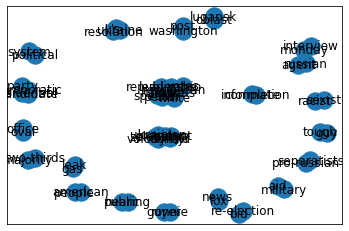

In [ ]:
banner('Example GPT-2 Discursive Object')
nx.draw_networkx(gpt_df['QDA_object'][200].graph)

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
~ Example Markovify Discursive Oject ~
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


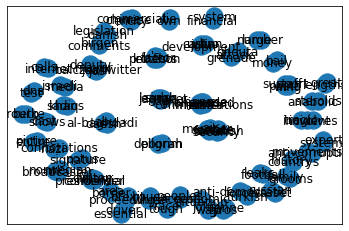

In [ ]:
banner('Example Markovify Discursive Oject')
nx.draw_networkx(markovify_df['QDA_object'][30].graph)

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
~ Example Sputnik Traning Discursive Object ~
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


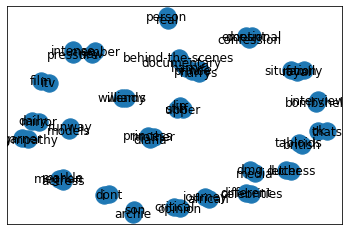

In [ ]:
banner('Example Sputnik Traning Discursive Object')
nx.draw_networkx(sputnik_training_df['QDA_object'][287].graph)

In [ ]:
print('Example human_object [training]')
#sputnik_training_df['QDA_object']
nx.draw(sputnik_training_df['QDA_object'][289].graph)

~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
~ Example Sputnik Control Discursive Object ~
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~


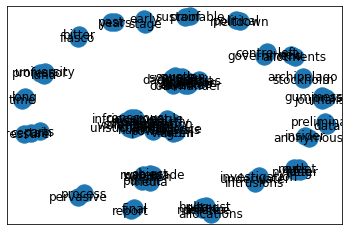

In [ ]:
banner('Example Sputnik Control Discursive Object')
nx.draw_networkx(sputnik_other_df['QDA_object'][4449].graph)

# License Information
MIT License

Copyright (c) 2020 Barney Ales

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.